NOTE: Please choose the *ebd* or your compatible custom kernel to execute this notebook

# NISAR Forest Disturbance Detection with Cumulative Sum Analysis
## Example: Fire Scar Detection in the Xingu Basin, Brazil

**Josef Kellndorfer, Ph.D., President and Senior Scientist, Earth Big Data, LLC**

Revision date: September 2021 

This notebook provides an overview of the algorithm, python implementation and an application example of the NISAR Disturbance algorithm. 

Note: The example data set is available at: [https://www.dropbox.com/sh/p3sgzaqrfnpuj6w/AACa-9clyMEhzG2VvJABwsf7a?dl=0)(https://www.dropbox.com/sh/p3sgzaqrfnpuj6w/AACa-9clyMEhzG2VvJABwsf7a?dl=0)

## Cumulative Sums for Change Detection
Our approach to detect change in regularly acquired NISAR data is employing cumulative sums. Changes are determined against mean observations of time series. Pre-seleection of observations in a SAR time series is necessary where large seasonal effects like freeze-thaw patterns or rainy season observations constrain the variation in backscatter levels. For example, in boreal regions, observations of disturbance solely observed in non-frozen periods after spring melt may be suitable for disturbance monitoring. 

### Time Series and means
First let's consider a time series and it's mean observation. 
We look at two full years of observations from Sentinel-1 data for an area where we suspect change. In the following we consider $X$ as a time series

$X = (X_1,X_2,...,X_n)$

with

- $X_i$  SAR backscatter at time $i=1,...,n$
- $n$ number of observations in the time series

Let's determind the residuals of the time series against the mean'

$R = X_i -\overline{X}$

Now we compute the cumulative sum of the residuals and plot it:

$S = \displaystyle\sum_1^n{R_i}$

An estimator for the magnitude of change is given as the difference between the maximum and minimum value of S

$S_{DIFF} = S_{MAX} - S_{MIN}$

A candidate change point is identified from the $S$ curve at the time where $S_{MAX}$ is found:

$T_{{CP}_{before}} = T(S_i = S_{MAX})$

with

- $T_{{CP}_{before}}$ Timestamp of last observation before change
- $S_i$    Cumulative Sum of R with $i=1,...n$
- $n$      Number of observations in the time series 

The first observation after change occured ($T_{{CP}_{after}}$) is then found as the first observation in the time series following $T_{{CP}_{before}}$.



## Bootstrapping the cumulative sums by randomly reordering the time series

We can determine if an identified change point is indeed a valid detection by randomly reordring the time series and comparing the various S curves. During bootstrapping we count how many times the $S_{DIFF}$ values are greater than $S_{{DIFF}_{random}}$ of the identified change point. A confindence level $CL$ is computed as

$CL = \frac{N_{GT}}{N_{bootstraps}}$

with 

- $N_{GT}$    Number of times $S_{DIFF}$ > $S_{{DIFF}_{random}}$  
- $N_{bootstraps}$    Number of bootstraps randomizing $R$

Another metric for the significance of a change point is 1 minus the ratio of the mean of the $S_{{DIFF}_{random}}$ values and $S_{DIFF}$. The closer this value is approaching 1, the more significant the change point: 

$CP_{significance} = 1 - \left( \frac{\sum_{b=1}^{N_{bootstraps}}{S_{{DIFF}_{{random}_i}}}}{N_{bootstraps}} \middle/ S_{DIFF} \right)$

## Python's *xarray*: Labeled Multidimensional Arrays for Analysis 

In this notebook we make use of python's *xarray* module for efficent time series exploration, visualization, and analysis.  
The python code to conduct the cumulative sum change point detection with boot strapping, including visualization of the S curves is implemented via xarrays and shown in this notebook.

#  Python Implementation

### Import of Modules

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
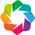

In [1]:
import os,sys
# Uncomment and adjust below if ebdpy.py resides in a different path 
# ebdpy_path='/notebooks/github/servir_training/notebooks_202006'
# sys.path.append(ebdpy_path)
# Add the current directory as a system path
sys.path.append('.')

import ebdpy as ebd
import glob

from skimage import exposure # to enhance image display

import numpy as np
import pandas as pd
import datetime as dt
import gdal
import xarray as xr
import hvplot.xarray

%matplotlib inline
import matplotlib.pylab as plt
import matplotlib.patches as patches  # Needed to draw rectangles
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')
import warnings
warnings.filterwarnings("ignore")

In [2]:
# In case changes are made to the ebdpy module, we can reload it with the importlib module
import importlib
importlib.reload(ebd)

<module 'ebdpy' from '/Users/josefk/github/private/notebooks/projects/C402_SERVIR/ebdpy.py'>

## Dask for scaling to multiple processors

Dask is well integrated with xarray to scale embarassingly parallel tasks to a local or remote cluster. We start a local dask client.

In [3]:
from dask.distributed import Client,LocalCluster

In [4]:
cluster=LocalCluster()
cluster

# Select the example data set and time series data

In [5]:
# Adjust the datapath and userdatapath to your local installation of data and temp directory
datapath='/Users/josefk/Dropbox/Data/C304/ATBD/Brazil'
userdatapath='/Users/josefk/junk/UserData'
os.makedirs(userdatapath,exist_ok=True)
os.chdir(datapath)

# List the available files in the data directory:

We are listing the available time series stacks and time series metrics files we are working with. For a data set description see the [Earth Big Data Data Guide](https://github.com/EarthBigData/openSAR/blob/master/documentation/EBD_DataGuide.md)

In [6]:
files=glob.glob(os.path.join(datapath,"*"))

In [7]:
ts_stacks=[x for x in files if x.endswith('_subset.tif') if not x.find('tsmetrics')>-1]
ts_metrics=[x for x in files if x.endswith('_tsmetrics_subset.tif')]
ts_stacks.sort()
ts_metrics.sort()
for i in zip(['ts_stacks','ts_metrics'],[ts_stacks,ts_metrics]):
    print(i[0])
    for j in i[1]:
        print(i[1].index(j),j)

ts_stacks
0 /Users/josefk/Dropbox/Data/C304/ATBD/Brazil/21LZF_20m_D_068_vh_subset.tif
1 /Users/josefk/Dropbox/Data/C304/ATBD/Brazil/21LZF_20m_D_068_vv_subset.tif
ts_metrics
0 /Users/josefk/Dropbox/Data/C304/ATBD/Brazil/21LZF_20m_D_068_vh_tsmetrics_subset.tif
1 /Users/josefk/Dropbox/Data/C304/ATBD/Brazil/21LZF_20m_D_068_vv_tsmetrics_subset.tif


## Set the time series stack index for a likepol and crosspol image name

Via the indices listed above, we can set what data set (cross- or like-polarized data) we want to work with.

In [8]:
xp=0
lp=1
likepol=ts_stacks[lp]
crosspol=ts_stacks[xp]

# Choose a polarization for the working data array

In [9]:
ds_source=crosspol
dsname=os.path.splitext(os.path.basename(ds_source))[0].replace('_mtfil','').replace('_subset','')
dsname

'21LZF_20m_D_068_vh'

## Read the SAR Time Series data stack
During reading, we are building a xarray dataset setting the time series index from the description attribute. We ensure that data are properly converted to power units. For details take a look at the source code of `ebdpy`.

In [10]:
da = ebd.read_sar(ds_source,dsname)

Explore the data array. Note that you can click on the *data disk symbol* to see details of the time series data stack.

In [11]:
da

<xarray.DataArray '21LZF_20m_D_068_vh' (time: 100, y: 1536, x: 1536)>
dask.array<where, shape=(100, 1536, 1536), dtype=float32, chunksize=(20, 500, 500), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 2017-01-03 2017-01-15 ... 2020-05-11
  * y        (y) float64 8.6e+06 8.6e+06 8.6e+06 ... 8.569e+06 8.569e+06
  * x        (x) float64 8e+05 8e+05 8e+05 ... 8.306e+05 8.307e+05 8.307e+05
Attributes:
    transform:      (20.0, 0.0, 799980.0, 0.0, -20.0, 8600020.0)
    crs:            +init=epsg:32721
    res:            (20.0, 20.0)
    is_tiled:       0
    nodatavals:     (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...
    scales:         (1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1...
    offsets:        (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...
    descriptions:   ('2017-01-03', '2017-01-15', '2017-01-27', '2017-02-08', ...
    AREA_OR_POINT:  Area

In [12]:
lastdate = da[-1]

In [13]:
timestamp=f'{lastdate.time.values}'.split('T')[0]
label=f'Sentinel-1 C-vh {timestamp}'
hv.Image(lastdate,kdims=['x','y'],label=label).opts(clim=(0.01,0.06),cmap='gray',width=600,height=600,tools=['hover']) 

:Image   [x,y]   (21LZF_20m_D_068_vh)

In [14]:
# Subset the data with coordinates xmin,ymin,xmax,ymax
# Brazil example
xmin,ymin,xmax,ymax=[810000,8580000,820000,8590000]
subset=[xmin,ymin,xmax,ymax]

# ul=[257931.546,743367.835]
# lr=[]
# sizemeters=15000
# if lr:
#     subset=[ul[0],ul[1],lr[0],lr[1]]
# else:
#     subset=[ul[0],ul[1],ul[0]+sizemeters,ul[1]-sizemeters]
da=ebd.da_subset_xy(da,subset)

Subset [810000, 8580000, 820000, 8590000] resulting in xmin,ymin,xmax,ymax indices 501 501 1001 1001


Let's take a look at the selected data array

In [16]:
da

<xarray.DataArray '21LZF_20m_D_068_vh' (time: 100, y: 500, x: 500)>
dask.array<getitem, shape=(100, 500, 500), dtype=float32, chunksize=(20, 499, 499), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 2017-01-03 2017-01-15 ... 2020-05-11
  * y        (y) float64 8.59e+06 8.59e+06 8.59e+06 ... 8.58e+06 8.58e+06
  * x        (x) float64 8.1e+05 8.1e+05 8.100e+05 ... 8.2e+05 8.2e+05 8.2e+05
Attributes:
    transform:      (20.0, 0.0, 810000.0, 0.0, -20.0, 8590000.0)
    crs:            +init=epsg:32721
    res:            (20.0, 20.0)
    is_tiled:       0
    nodatavals:     (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...
    scales:         (1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1...
    offsets:        (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...
    descriptions:   ('2017-01-03', '2017-01-15', '2017-01-27', '2017-02-08', ...
    AREA_OR_POINT:  Area

We are defining a baseline period in the time series by defining a split point:

In [16]:
ts_splitpoint='2017-09-30'
da_baseline=da.sel(time=slice('2017-01-01',ts_splitpoint))
# da=da.sel(time=slice(ts_splitpoint,'2020-05-11')).chunk({'x':-1,'y':-1})


Let's take a look the baseline data array

In [17]:
da_baseline

<xarray.DataArray '21LZF_20m_D_068_vh' (time: 23, y: 500, x: 500)>
dask.array<getitem, shape=(23, 500, 500), dtype=float32, chunksize=(20, 499, 499), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 2017-01-03 2017-01-15 ... 2017-09-24
  * y        (y) float64 8.59e+06 8.59e+06 8.59e+06 ... 8.58e+06 8.58e+06
  * x        (x) float64 8.1e+05 8.1e+05 8.100e+05 ... 8.2e+05 8.2e+05 8.2e+05
Attributes:
    transform:      (20.0, 0.0, 810000.0, 0.0, -20.0, 8590000.0)
    crs:            +init=epsg:32721
    res:            (20.0, 20.0)
    is_tiled:       0
    nodatavals:     (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...
    scales:         (1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1...
    offsets:        (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0...
    descriptions:   ('2017-01-03', '2017-01-15', '2017-01-27', '2017-02-08', ...
    AREA_OR_POINT:  Area

## Let's make a crude forest/non-forest mask for the baseline period from COV thresholding

In order to reduce the data volume to analyze, it might be useful to mask out areas that were predominantly not forest during the observation baseline period.
We compute the Coefficient of Variation (CoV) for the baseline period from January to September 2017. From thresholding the CoV we can generate a crude forest/non-forest mask based on low CoV values with

${mask}_{forest} = {CoV} < {thres}$

In [18]:
cov=da_baseline.std('time')/da_baseline.mean('time')

We can visualize the CoV and interactively explore the values to find a suitable threshold.

In [19]:
label='Coefficient of Variation for baseline period'
hv.Image(cov,kdims=['x','y'],label=label).opts(cmap='viridis',width=600,height=600,tools=['hover']) 

:Image   [x,y]   (21LZF_20m_D_068_vh)

Let's determine a threshold from the plot above to make a mask and look at it.

In [20]:
cov_thres=0.2
forest_mask=cov<cov_thres
label='Forest/Non-Forest mask for baseline period'
hv.Image(forest_mask,kdims=['x','y'],label=label).opts(cmap='Greens',width=600,height=600,tools=['hover']) 

:Image   [x,y]   (21LZF_20m_D_068_vh)

Add the mask to the data array ...

In [22]:
da.coords['mask'] = (('y', 'x'), forest_mask.values) 

... and apply it on the data array itself.

In [23]:
da = da.where(da.mask)

Note: We could skip the step of adding the mask to the data array and supply forest_mask straight to the da.where() function.

    da = da.where(forest_mask)

Check with a plot if aplying the mask worked:

In [24]:
da_mean = da.mean('time')
label='Masked data array for further analysis - Mean of observation period'
hv.Image(da_mean,kdims=['x','y'],label=label).opts(cmap='viridis',width=600,height=600,tools=['hover']) 

:Image   [x,y]   (21LZF_20m_D_068_vh)

## Visual Impression of Disturbance: RGB Plot of Time Series Max/Min Difference from the Mean

Let's make a plot of time series metrics where we take the difference with the mean of the maximum and minimum backscatter values. We generate three RGB bands for that from the time series stack Mean, Mean-Min, and Max-Mean

In [25]:
g=da.mean('time')
r=g-da.min('time')
b=da.max('time')-g
rgb=np.dstack([r.values,g.values,b.values])
# Let's histogram equalize the data
rgb_stretched=ebd.rgb_stretch(rgb)

In [26]:
ebd.rgb_plot(rgb_stretched,da,f"RGB Time Series Mean-Min/Mean/Max-Mean ({dsname})")

:RGB   [Easting [m] (EPSG:32721),Northing [m]]   (R,G,B)

### Finding:

Looks like the areas for degradation can be identified. Let's see if we can find a classifier for it. 

# Select the time series segment to analyze

Let's see if we can find trends of change by comparing the minimum SAR backscatter in each quarter.
To reduce data volumes and form a more stable signal of SAR backscatter less affected by athmospheric distortions (see SAR Handbook for moisture variations in backscatter) we are resampling the data to three months time series segments within which we calculate the minima. 

This can readily be accomplished with the xarray data array *resample* function.

In [27]:
resampler = da.resample(time='3M',keep_attrs=True)
mymetric='minimum'
qmetric=resampler.min(keep_attrs=True).chunk({'x':-1,'y':-1})

In [28]:
# To work with the non resmapled stack uncomment here
# mymetric='all'
# qmetric=da.chunk({'x':-1,'y':-1})

Plot of minimum of 36 day periods


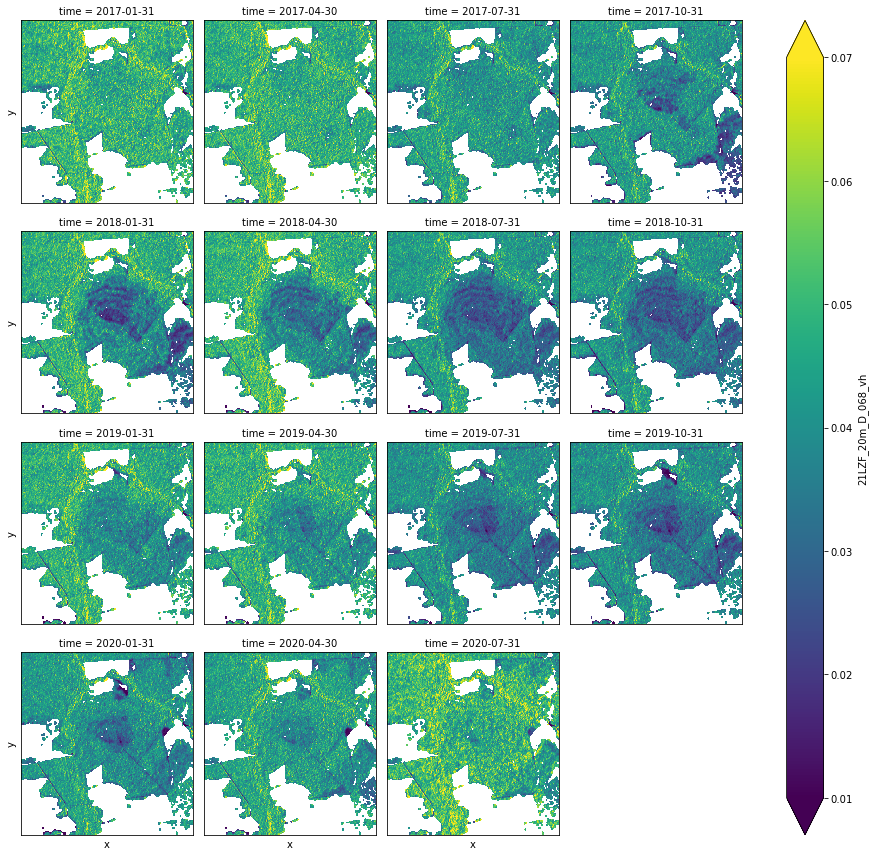

In [29]:
print(f'Plot of {mymetric} of 36 day periods')
myplt = qmetric.plot(col='time',col_wrap=4,cmap='viridis',vmin=0.01,vmax=0.07,xticks=[],yticks=[])

## Let's look at Seasonality

We are interested if we are affected by seasonality. 

We plot the quarterly metrics, e.g. the image mean, minimum, 2nd percentile, 98th percentile to see if we have a strong seasonality signal (i.e. a non-stationary time series signal).

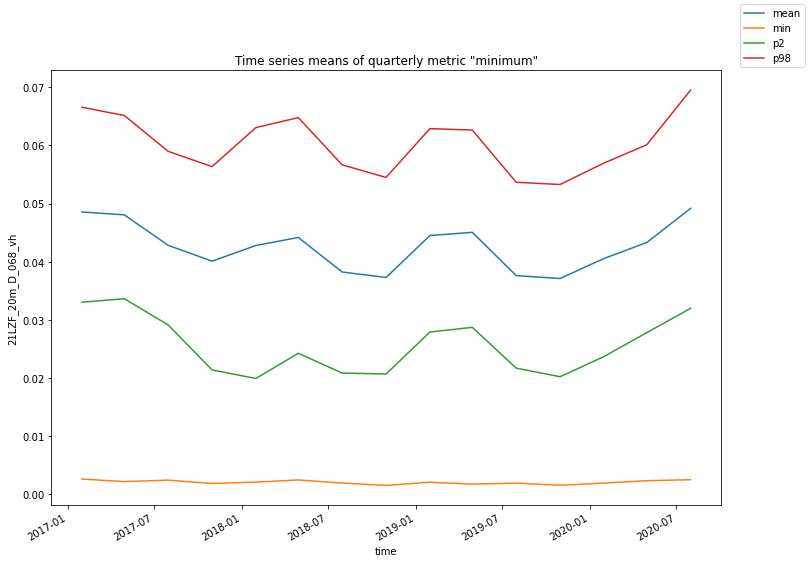

In [30]:
fig,ax=plt.subplots(1,1,figsize=(12,8))
qmetric.mean(dim=['x','y']).plot(ax=ax,label='mean')
qmetric.min(dim=['x','y']).plot(ax=ax,label='min')
#qmetric.max(dim=['x','y']).plot(ax=ax,label='max')
q=[0.02,.98]
pl,ph=qmetric.quantile(q,dim=['x','y'])
pl.plot(ax=ax,label=f'p{q[0]*100:.0f}')
ph.plot(ax=ax,label=f'p{q[1]*100:.0f}')
ax.set_title(f'Time series means of quarterly metric "{mymetric}"')
fig.legend()

Looks like we see the wet/dry-season cycles in the data and need to be mindful of the effect in further analysis. If we think the seasonality effects are too strong and introduce ambiguities with real change signals, we might consider further subsetting of the data set, e.g. to select only dryseason data. 

## Compute the Residuals of the resampled quaterly metrics to the mean of the metric

In [31]:
#qmetric.mean('time').plot(vmin=0.01,vmax=0.1,figsize=(12,10))
label=f'Mean of quarterly minima of Sentinel-1 backscatter'
hv.Image(qmetric.mean('time'),kdims=['x','y'],label=label).opts(clim=(0.01,0.07),cmap='viridis',width=600,height=600,tools=['hover']) 

:Image   [x,y]   (21LZF_20m_D_068_vh)

## A look at the time series of the residuals

Let's take a look at the residuals over time in the various quarters. This should give us an impression during which quarter we see deviations from the mean. 

In [32]:
qmetric_residuals=qmetric-qmetric.mean('time').persist()

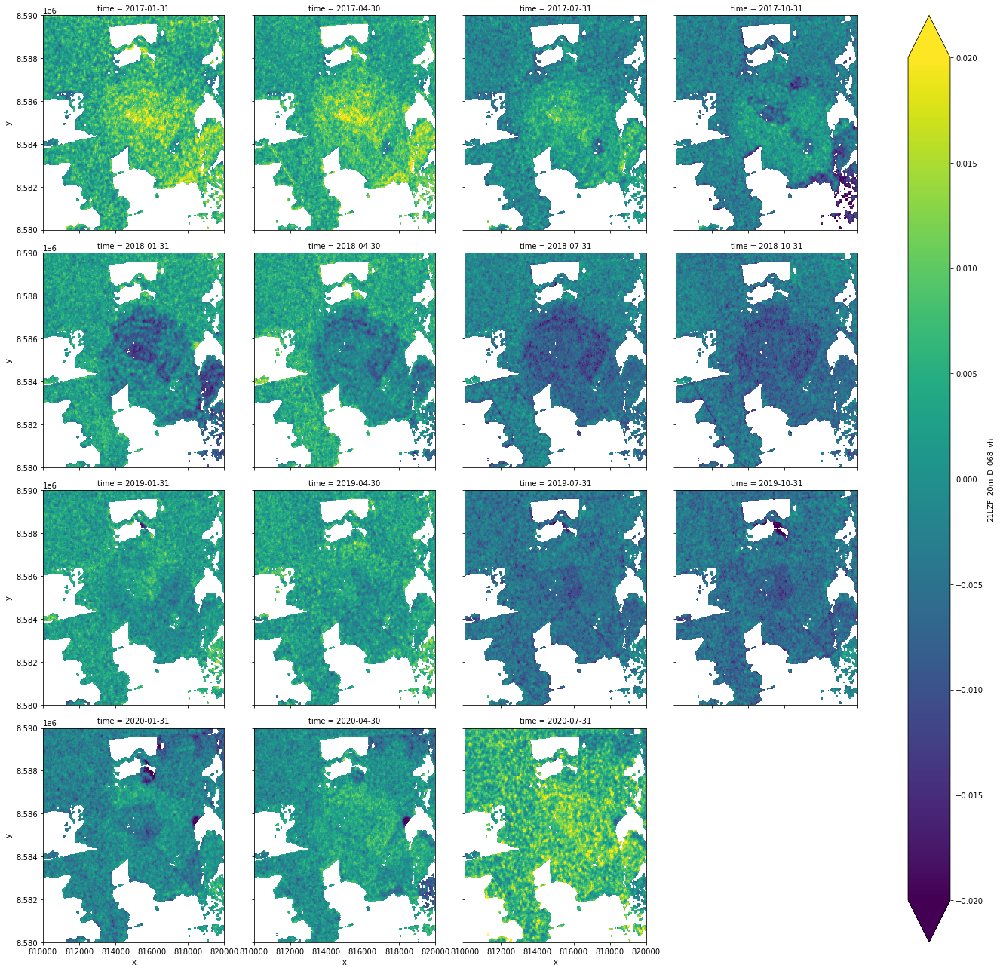

In [33]:
qmetric_residuals.plot(col='time',col_wrap=4,figsize=(20,18),vmin=-0.02,vmax=0.02)

## Cumulative Sum Change Point Detection of the Fire Scar 

1. Compute the cumulative sums of the residuals

In [34]:
S = qmetric_residuals.cumsum('time')

Text(0, 0.5, 'Cumulative Sum of Residual from Mean')

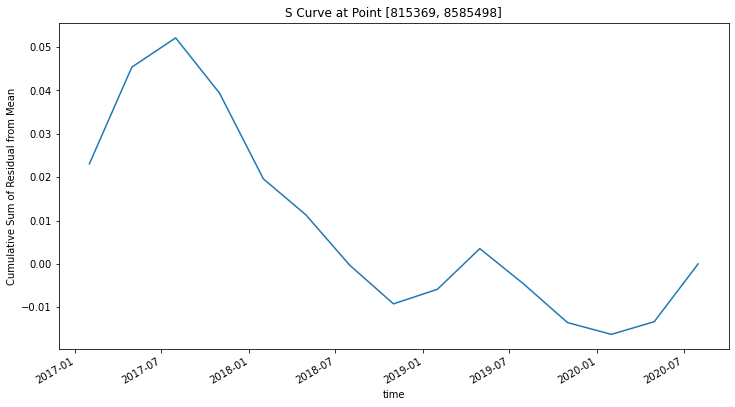

In [35]:
# Example S Curve at a specific point
pt=[815369,8585498]
Spt= S.sel({'x':pt[0],'y':pt[1]},method='nearest').persist()

fig,ax=plt.subplots(figsize=(12,6))
Spt.plot(ax=ax)
ax.set_title(f'S Curve at Point {pt}')
ax.set_ylabel('Cumulative Sum of Residual from Mean')

2. Compute the maxmima, minima, and difference of max minus min from the cumulative sum curves

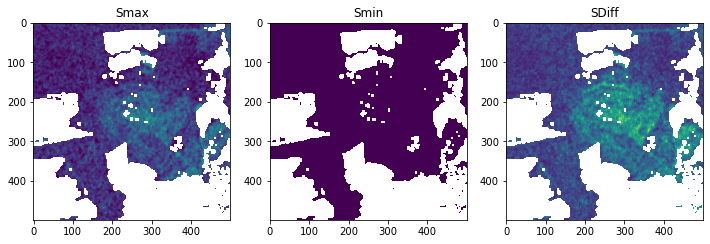

In [36]:
Smax=S.where(S.mask).max('time')
Smin=S.where(S.mask).min('time')
SDiff=Smax-Smin
fig,ax=plt.subplots(1,3,figsize=(12,24))
vmin=np.nanmin(SDiff.values)
vmax=np.nanmax(SDiff.values)
# ax[0].imshow(Smax.values)
# ax[1].imshow(Smin.values)
# ax[2].imshow(SDiff.values)
ax[0].imshow(Smax.values,vmin=vmin,vmax=vmax)
ax[1].imshow(Smin.values,vmin=vmin,vmax=vmax)
ax[2].imshow(SDiff.values,vmin=vmin,vmax=vmax)
ax[0].set_title('Smax' )
ax[1].set_title('Smin' )
_=ax[2].set_title('SDiff')

In [37]:
# A larger interactive look at SDiff 
label='SDiff Image'
hv.Image(SDiff,kdims=['x','y'],label=label).opts(width=800,height=800,cmap='viridis',tools=['hover'])

:Image   [x,y]   (21LZF_20m_D_068_vh)

## Setting a threshold for SDiff to further mask the data to evaluate

Because we applied a forest mask to our subsetted data stack, we can determine a threshold for disturbance candidates to set a new. additional mask under which we would consider change points. This helps in data reduction of subsequent analysis, e.g. to reduce the amount of bootstraps over the entire image space.

We can pick a threshold from the interactive plot. Or:

If we assume a gaussian distribution, we could set a threshold as a multiple of the standard deviation of the mean in the SDiff pdf:

$thres = \overline{S_{Diff}} + x \times \sigma_{S_{Diff}}$

with 
$x$  factor for $\sigma$ multiplication from the mean.

In [38]:
x=1
dthres=float(SDiff.mean()+x*SDiff.std())
print(f'Setting the threshold for SDiff to {x}*Std.Dev.: {dthres:.2f}')

Setting the threshold for SDiff to 1*Std.Dev.: 0.04


Let's plot the histogram to confirm a quasi Gaussian pdf for SDiff.

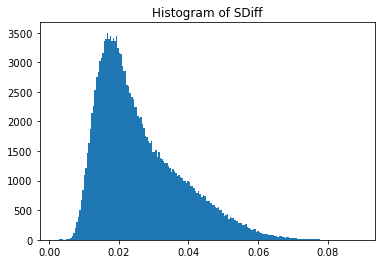

In [39]:
_=plt.hist(SDiff.values.flatten(),bins=200)
_=plt.title('Histogram of SDiff')

If it's not Guassian, we might be better off using a threshold based in percentile, let's say we want to find a threshold value above which we have the highest 20% of the data

In [40]:
arr = SDiff.values.flatten()
dthres = np.nanpercentile(arr,80)
print(f'Setting the threshold for SDiff to: {dthres:.3f}')

Setting the threshold for SDiff to: 0.036


### Applying the threshold to the mask

In [41]:
dmask=SDiff>dthres

### Plot the mask

In [42]:
# plt.figure(figsize=(8,8))
# dmask.plot(cmap='Reds',figsize=(10,8))
# _=plt.title(f'Forest Disturbance after {ts_splitpoint} from CumSum Classifier. SDiff Threshold: {dthres:.2f}')

label=f'Mask for CumSum Classifier for further analysis based on SDiff Threshold: {dthres:.2f}'
hv.Image(dmask,kdims=['x','y'],label=label).opts(width=800,height=800,cmap='Reds',tools=['hover'])

:Image   [x,y]   (21LZF_20m_D_068_vh)

## Bootstrapping on the candidate change points to confirm validity of an identified change point

1. Apply the mask the the data stacks
2. Run boot strapping on the dectection by randomizing the time series in varying time steps

In [ ]:
# 1. Apply the mask

In [44]:
qmetric_residuals.coords['mask'] = (('y', 'x'), dmask.values) 
qmetric_residuals = qmetric_residuals.where(qmetric_residuals.mask)

In [46]:
S_masked=qmetric_residuals.cumsum('time')
Smax_masked=S.where(S.mask).max('time')
Smin_masked=S.where(S.mask).min('time')
SDiff_masked=Smax_masked-Smin_masked
SDiff_masked.coords['mask'] = (('y', 'x'), dmask.values) 
SDiff_masked = SDiff_masked.where(SDiff_masked.mask)

In [47]:
label=f'Fire Disturbance after {ts_splitpoint} from CumSum Classifier: SDiff'
hv.Image(SDiff_masked,kdims=['x','y'],label=label).opts(width=800,height=800,cmap='viridis',tools=['hover'])

:Image   [x,y]   (21LZF_20m_D_068_vh)

In [48]:
# Set the number of bootstraps to > 100, for demonstration purposes with start with 10
n_bootstraps=20  

In [49]:
# to keep track of the maxium Sdiff of the bootstrapped sample:
Sdiff_random_max = qmetric_residuals.mean('time').copy() 
Sdiff_random_max=Sdiff_random_max.where(Sdiff_random_max.mask,0)
# to compute the Sdiff sums of the bootstrapped sample:
Sdiff_random_sum = qmetric_residuals.mean('time').copy() 
Sdiff_random_sum=Sdiff_random_sum.where(Sdiff_random_max.mask,0)
# to keep track of the count of the bootstrapped sample
# n_Sdiff_gt_Sdiff_random = qmetric_residuals.mean('time').copy() 
# n_Sdiff_gt_Sdiff_random=n_Sdiff_gt_Sdiff_random.where(n_Sdiff_gt_Sdiff_random.mask,0)
n_Sdiff_gt_Sdiff_random=np.ma.zeros((qmetric_residuals.shape[1],qmetric_residuals.shape[2]))

In [50]:
# to compute the Sdiff sums of the bootstrapped sample:

for i in range(n_bootstraps):
    # For efficiency, we shuffle the time axis index and use that 
    #to randomize the masked array
    permutation=np.random.permutation(len(qmetric_residuals))
    Srandom = qmetric_residuals[permutation].cumsum('time')
    Srandom_max=Srandom.where(Srandom.mask).max('time')
    Srandom_min=Srandom.where(Srandom.mask).min('time')
    Sdiff_random=Srandom_max-Srandom_min
    
    Sdiff_random_sum += Sdiff_random
    # Mask where Sdiff_random is greater than Sdiff_random_max
    gtmask=np.ma.greater(Sdiff_random,Sdiff_random_max).data
    Sdiff_random_max.where(gtmask,Sdiff_random.where(np.ma.greater(Sdiff_random,Sdiff_random_max).data).values)
    n_Sdiff_gt_Sdiff_random[np.ma.greater(SDiff_masked,Sdiff_random)] += 1

Now let's compute the confidence level CL:

In [51]:
CL = n_Sdiff_gt_Sdiff_random/n_bootstraps

Now we set a threshold which reflect the combination of confidence and siginificance. Let's plot it.

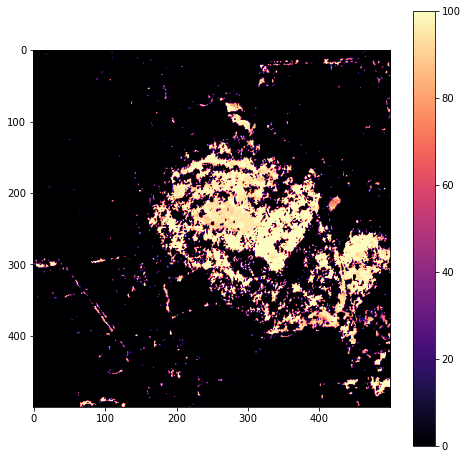

In [52]:
fig,ax=plt.subplots(1,1,figsize=(8,8))
a = ax.imshow(CL*100,cmap='magma')
_=fig.colorbar(a,ax=ax)


Let's set the threshold for confidence of the bootstrapping to 90% and make the change point mask:

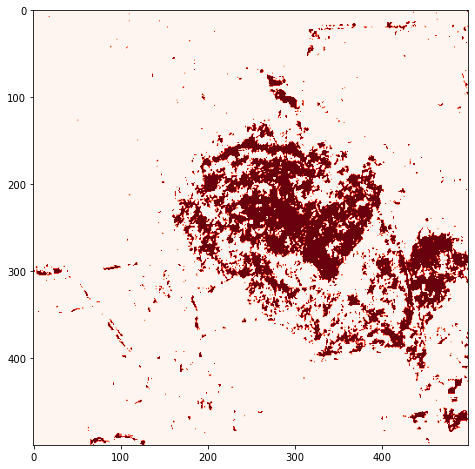

In [53]:
cp_thres=0.85

plt.figure(figsize=(8,8))
_=plt.imshow(CL > cp_thres,cmap='Reds')

Our last step is the idenficiaton of the change points is to extract the timing of the change. We will produce a raster layer that shows the band number of this first date after detected change. We will make use of the numpy indexing scheme. First, we create a combined mask of the first threshold and the identified change points after the bootstrapping. For this we use the numpy "mask_or" operation.


In [54]:
Smasked=S_masked.copy()
# Convert the numpy datetime64 format to datetime date
alldates=[pd.Timestamp(x).to_pydatetime().date() for x in S_masked.time.values]

# mask
#cp_mask=np.ma.mask_or(CL*CP_significance<cp_thres,CL.mask)
cp_mask=CL>cp_thres
# Broadcast the mask to the shape of the masked S curves
cp_mask2 = np.broadcast_to(cp_mask,Smasked.shape)
# Make a numpy masked array with this mask
CPraster = np.ma.array(Smasked,mask=cp_mask2)

CPraster=Smasked.where(cp_mask2)


To retrieve the dates of the change points we find the band indices in the time series along the time axis where the the maximum of the cumulative sums was located. Numpy offers the "argmax" function for this purpose.

Let's visualize where we see the maxima over time (where yellowness is highest in the next set of plots)

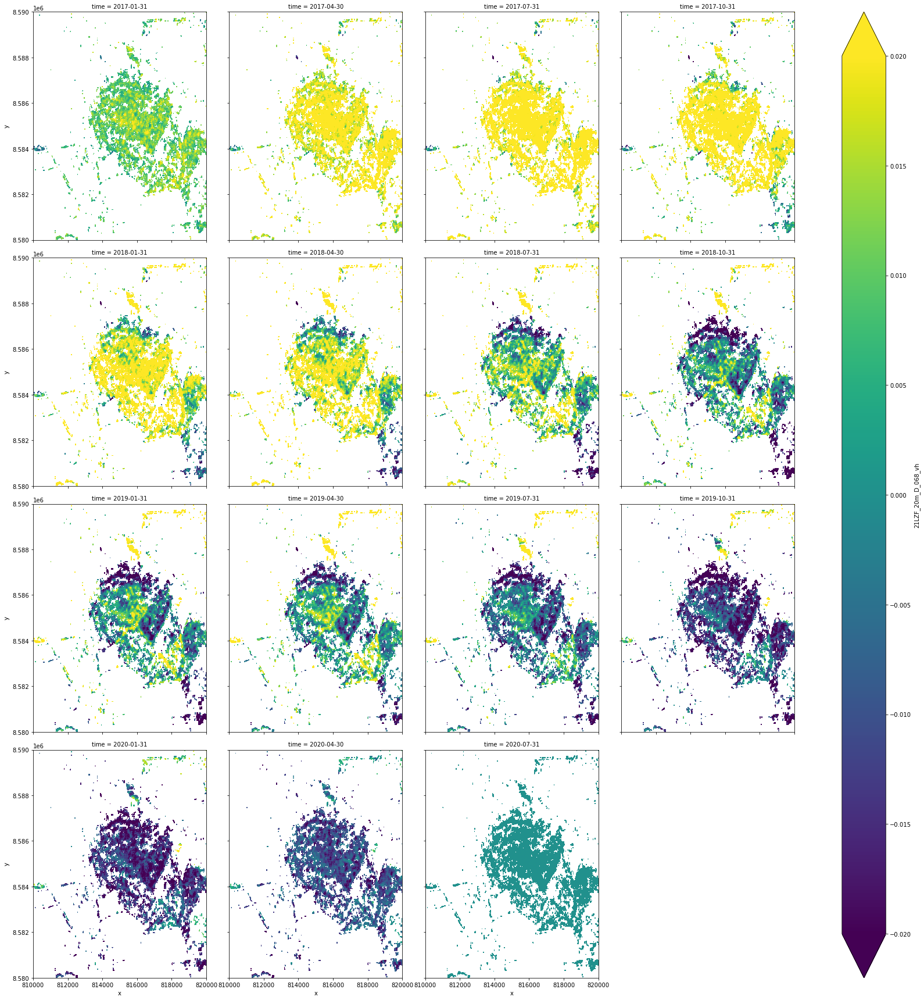

In [55]:
_=CPraster.plot(col='time',col_wrap=4,figsize=(24,24),vmin=-0.02,vmax=0.02)

 Get the change dates via the argmax function

In [56]:
CPraster2 = np.array(CPraster.values)

CP_index = np.argmax(CPraster2,axis=0)

change_indices=np.unique(CP_index)
change_indices.sort()

list(change_indices)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14]

In [57]:
change_dates=list(set([alldates[x+1] if x<len(alldates)-1 else alldates[x]  for x in change_indices ]))
change_dates.sort()
change_dates

[datetime.date(2017, 4, 30),
 datetime.date(2017, 7, 31),
 datetime.date(2017, 10, 31),
 datetime.date(2018, 1, 31),
 datetime.date(2018, 4, 30),
 datetime.date(2018, 7, 31),
 datetime.date(2018, 10, 31),
 datetime.date(2019, 1, 31),
 datetime.date(2019, 4, 30),
 datetime.date(2019, 7, 31),
 datetime.date(2019, 10, 31),
 datetime.date(2020, 1, 31),
 datetime.date(2020, 7, 31)]

In [58]:
# Make a masked change point index layer
CP_index_masked=np.ma.array(CP_index,mask=~cp_mask)

Lastly, we visualize the change dates by showing the CP_index raster and label the change dates.

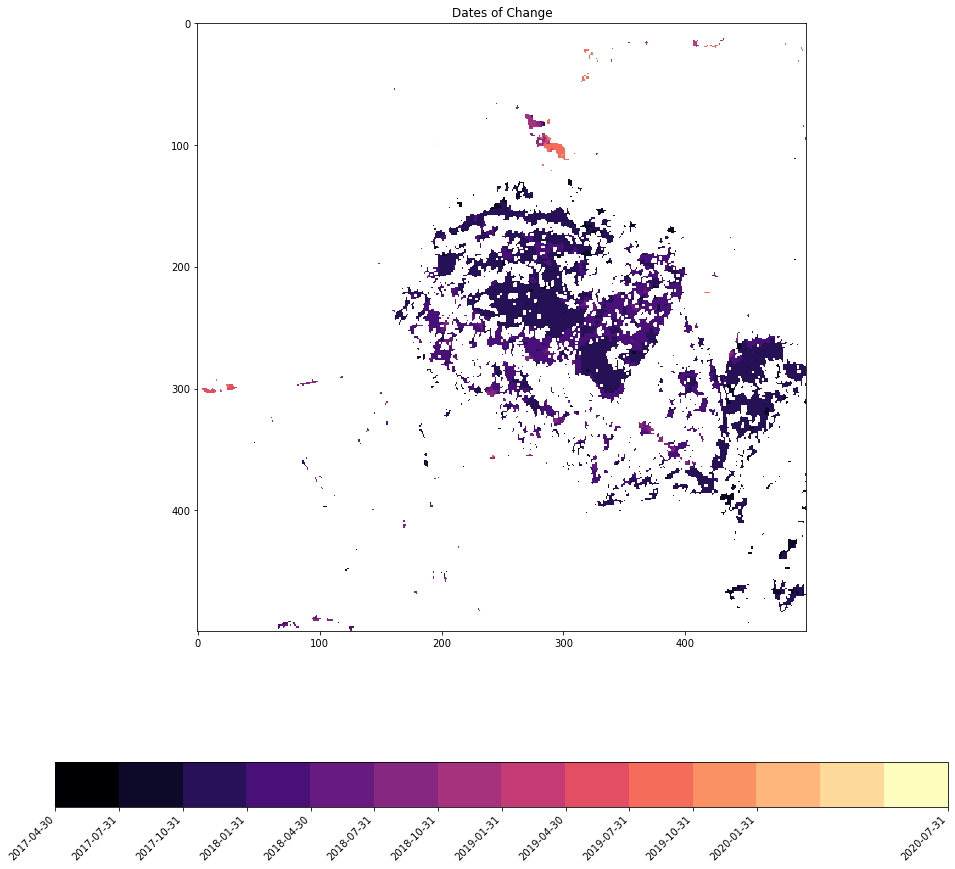

In [59]:
ticks=change_indices
ticklabels=change_dates
cmap=plt.cm.get_cmap('magma',ticks[-1])
fig, ax = plt.subplots(figsize=(16,16))
# cax = ax.imshow(CP_index_masked,interpolation='nearest',cmap=cmap)
cax = ax.imshow(CP_index_masked,cmap=cmap)
# fig.subplots_adjust(right=0.8)
# cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
# fig.colorbar(p,cax=cbar_ax)

ax.set_title('Dates of Change')
# cbar = fig.colorbar(cax,ticks=ticks)
cbar=fig.colorbar(cax,ticks=ticks,orientation='horizontal')
_=cbar.ax.set_xticklabels(ticklabels,size=10,rotation=45,ha='right')  

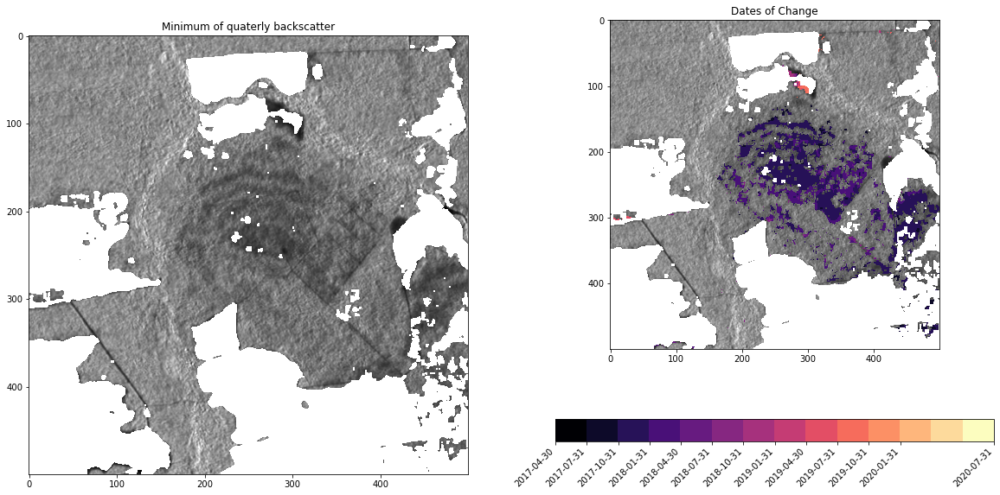

In [60]:
# And plotted overlayed on the mean of our quaterly metrics

fig,ax = plt.subplots(1,2,figsize=(20,10))
ax[0].imshow(qmetric.min('time').values,cmap='gray',vmin=0,vmax=0.07)
ax[0].set_title('Minimum of quaterly backscatter')
ax[1].imshow(qmetric.min('time').values,cmap='gray',vmin=0,vmax=0.07)
ax[1].imshow(CP_index_masked,cmap=cmap)
ax[1].set_title('Dates of Change')
# cbar = fig.colorbar(cax,ticks=ticks)
cbar=fig.colorbar(cax,ticks=ticks,orientation='horizontal')
_=cbar.ax.set_xticklabels(ticklabels,size=10,rotation=45,ha='right')  

## Write the result to disk

In [61]:
Name=os.path.join(userdatapath,f'{dsname}_CumSum_disturbance_{dthres*10000:.0f}.tif')
Name_lut=Name.replace('.tif','_changedates.lut')

In [62]:
GeoT=ebd.transform2geotras(da.transform)
GeoT

(810000.0, 20.0, 0.0, 8590000.0, 0.0, -20.0)

In [63]:
# Create the tif
mytype=np.uint8 if CP_index_masked.max() < 255 else np.uint32
ebd.CreateGeoTiff(Array=CP_index_masked.filled(0).astype(mytype),Name=Name,GeoT=GeoT,ref_image=ds_source,overwrite=True)
print(gdal.Info(Name))

Driver: GTiff/GeoTIFF
Files: /Users/josefk/junk/UserData/21LZF_20m_D_068_vh_CumSum_disturbance_360.tif
Size is 500, 500
Coordinate System is:
PROJCRS["WGS 84 / UTM zone 21S",
    BASEGEOGCRS["WGS 84",
        DATUM["World Geodetic System 1984",
            ELLIPSOID["WGS 84",6378137,298.257223563,
                LENGTHUNIT["metre",1]]],
        PRIMEM["Greenwich",0,
            ANGLEUNIT["degree",0.0174532925199433]],
        ID["EPSG",4326]],
    CONVERSION["UTM zone 21S",
        METHOD["Transverse Mercator",
            ID["EPSG",9807]],
        PARAMETER["Latitude of natural origin",0,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8801]],
        PARAMETER["Longitude of natural origin",-57,
            ANGLEUNIT["degree",0.0174532925199433],
            ID["EPSG",8802]],
        PARAMETER["Scale factor at natural origin",0.9996,
            SCALEUNIT["unity",1],
            ID["EPSG",8805]],
        PARAMETER["False easting",500000,
            LENGTHUN

In [64]:
# Write the Changedate LUT:
with open(Name_lut,"w") as f:
    for i in zip(ticks,ticklabels):
        f.write(f'{i[0]},\t{i[1]}\n')

# Summary

We have shown how cumulative sums can be used to identify forest degradation from fire in the Xingu Basin from time series of Sentinel-1 data. Bootstrapping by randomizing the order of the time series allows us to confirm the strength of a change point.
